In [26]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [27]:
train_data = pd.read_csv('data/train.csv')
test_data = pd.read_csv('data/hidden_test.csv')

In [28]:
train_data.head()

,0,1,2,3,4,5,6,7,8,9,...,44,45,46,47,48,49,50,51,52,target
0,236,488,16,221,382,97,-4.472136,0.107472,0,132,...,13.340874,0.870542,1.962937,7.466666,11.547794,8.822916,9.046424,7.895535,11.010677,20.107472
1,386,206,357,232,1,198,7.810250,0.763713,1,143,...,12.484882,7.168680,2.885415,12.413973,10.260494,10.091351,9.270888,3.173994,13.921871,61.763713
2,429,49,481,111,111,146,8.602325,0.651162,1,430,...,14.030257,0.394970,8.160625,12.592059,8.937577,2.265191,11.255721,12.794841,12.080951,74.651162
3,414,350,481,370,208,158,8.306624,0.424645,1,340,...,2.789577,6.416708,10.549814,11.456437,6.468099,2.519049,0.258284,9.317696,5.383098,69.424645
4,318,359,20,218,317,301,8.124038,0.767304,1,212,...,1.886560,1.919999,2.268203,0.149421,4.105907,10.416291,6.816217,8.586960,4.512419,66.767304


In [29]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90000 entries, 0 to 89999
Data columns (total 54 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       90000 non-null  int64  
 1   1       90000 non-null  int64  
 2   2       90000 non-null  int64  
 3   3       90000 non-null  int64  
 4   4       90000 non-null  int64  
 5   5       90000 non-null  int64  
 6   6       90000 non-null  float64
 7   7       90000 non-null  float64
 8   8       90000 non-null  int64  
 9   9       90000 non-null  int64  
 10  10      90000 non-null  int64  
 11  11      90000 non-null  int64  
 12  12      90000 non-null  int64  
 13  13      90000 non-null  float64
 14  14      90000 non-null  float64
 15  15      90000 non-null  float64
 16  16      90000 non-null  float64
 17  17      90000 non-null  float64
 18  18      90000 non-null  float64
 19  19      90000 non-null  float64
 20  20      90000 non-null  float64
 21  21      90000 non-null  float64
 22

In [30]:
train_data.iloc[:, :10].describe()

,0,1,2,3,4,5,6,7,8,9
count,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000
mean,249.423944,250.236267,248.637289,249.736600,249.436178,249.656167,-0.011402,0.498548,0.499189,249.842033
std,144.336393,144.022200,144.107577,144.284945,143.941581,144.329168,7.038171,0.288682,0.500002,144.612718
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.949874,0.000014,0.000000,0.000000
25%,125.000000,126.000000,124.000000,125.000000,125.000000,124.000000,-7.071068,0.248932,0.000000,124.000000
50%,250.000000,251.000000,248.000000,250.000000,250.000000,250.000000,0.000000,0.497136,0.000000,250.000000
75%,374.000000,375.000000,374.000000,375.000000,373.000000,374.000000,7.000000,0.747513,1.000000,376.000000
max,499.000000,499.000000,499.000000,499.000000,499.000000,499.000000,9.949874,0.999987,1.000000,499.000000


In [31]:
train_data.iloc[:, 10:20].describe()

,10,11,12,13,14,15,16,17,18,19
count,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000
mean,249.818967,249.346778,249.899900,7.483940,7.498037,7.496259,7.501635,7.486463,7.523043,7.475585
std,144.363827,144.476128,144.310495,4.330908,4.318388,4.338732,4.345618,4.318031,4.323500,4.327327
min,0.000000,0.000000,0.000000,0.000095,0.000252,0.000190,0.000192,0.000067,0.000229,0.000125
25%,126.000000,124.000000,125.000000,3.723392,3.763626,3.718755,3.719537,3.758746,3.778857,3.733780
50%,250.000000,249.000000,251.000000,7.483265,7.505267,7.502682,7.515240,7.467721,7.539462,7.460267
75%,375.000000,375.000000,375.000000,11.242883,11.228331,11.258049,11.284618,11.238904,11.254751,11.211187
max,499.000000,499.000000,499.000000,14.999920,14.999938,14.999660,14.999979,14.999840,14.999857,14.999634


In [32]:
train_data.iloc[:, 20:30].describe()

,20,21,22,23,24,25,26,27,28,29
count,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000
mean,7.494835,7.503939,7.507724,7.508681,7.472421,7.519205,7.515753,7.509402,7.496781,7.504014
std,4.325447,4.330159,4.332599,4.328966,4.345228,4.339104,4.333907,4.331007,4.334982,4.318553
min,0.000382,0.000398,0.000140,0.000382,0.000129,0.000192,0.000017,0.000080,0.000161,0.000437
25%,3.748951,3.760261,3.742810,3.768145,3.685140,3.760790,3.746467,3.772795,3.741697,3.774239
50%,7.481500,7.521563,7.520793,7.520739,7.484349,7.526894,7.528984,7.494876,7.491009,7.500083
75%,11.238128,11.248749,11.244657,11.240915,11.239795,11.276738,11.272683,11.271486,11.257988,11.233189
max,14.999953,14.999483,14.999762,14.999875,14.999987,14.999651,14.999995,14.999838,14.999958,14.999841


In [33]:
train_data.iloc[:, 30:40].describe()

,30,31,32,33,34,35,36,37,38,39
count,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000
mean,7.494212,7.490808,7.486936,7.514508,7.491614,7.520193,7.507801,7.493713,7.513840,7.507033
std,4.327286,4.322672,4.329524,4.329973,4.333144,4.335244,4.329515,4.327480,4.333543,4.327670
min,0.000041,0.000070,0.000074,0.000111,0.000067,0.000078,0.000018,0.000094,0.000020,0.000106
25%,3.743116,3.763061,3.750034,3.778028,3.743842,3.752848,3.776405,3.755325,3.754465,3.771945
50%,7.514475,7.483334,7.458614,7.513794,7.475324,7.550623,7.484699,7.472789,7.518614,7.504101
75%,11.223296,11.229486,11.245719,11.272623,11.241922,11.261178,11.255442,11.251097,11.270277,11.241504
max,14.999808,14.999927,14.999896,14.999871,14.999558,14.999898,14.999997,14.999822,14.999958,14.999933


In [34]:
train_data.iloc[:, 40:54].describe()

,40,41,42,43,44,45,46,47,48,49,50,51,52,target
count,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000
mean,7.479579,7.519826,7.502483,7.512965,7.475155,7.523962,7.508397,7.473322,7.490658,7.474578,7.509206,7.487159,7.513316,50.033981
std,4.326175,4.315565,4.333881,4.329929,4.330410,4.321537,4.331761,4.335692,4.332122,4.323035,4.326364,4.324876,4.333080,28.897243
min,0.000105,0.000273,0.000315,0.000060,0.000019,0.000040,0.000154,0.000083,0.000367,0.000014,0.000160,0.000147,0.000125,0.002634
25%,3.731527,3.784809,3.763004,3.768044,3.707544,3.797002,3.760627,3.715721,3.739358,3.715298,3.773381,3.743536,3.776322,25.091903
50%,7.452493,7.532363,7.511806,7.507058,7.474127,7.533987,7.505259,7.459774,7.494167,7.477270,7.512575,7.476564,7.506812,50.030705
75%,11.222543,11.241135,11.255483,11.272459,11.216585,11.276349,11.261971,11.215637,11.239232,11.210070,11.268156,11.234414,11.277835,75.059454
max,14.999704,14.999940,14.999739,14.999605,14.999900,14.999528,14.999733,14.999478,14.999869,14.999928,14.999948,14.999364,14.999775,99.999482


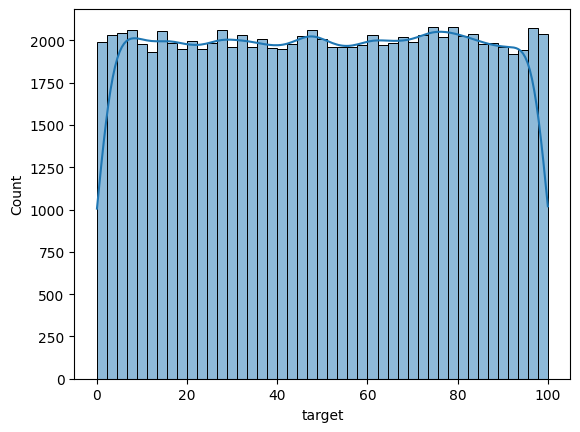

In [35]:
sns.histplot(train_data['target'], kde=True)
plt.show()

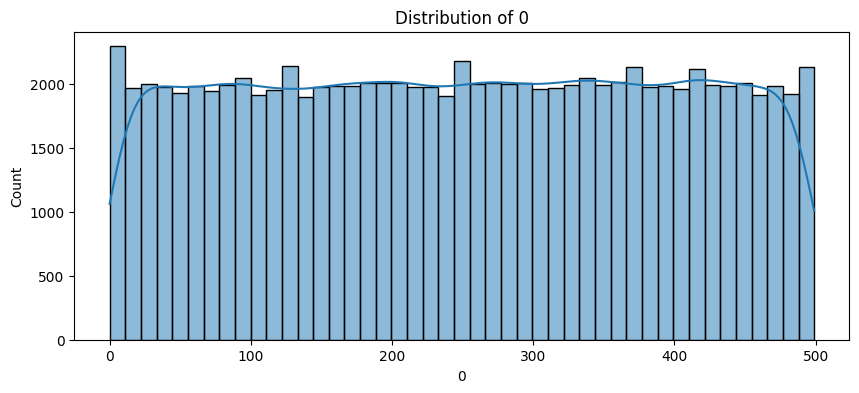

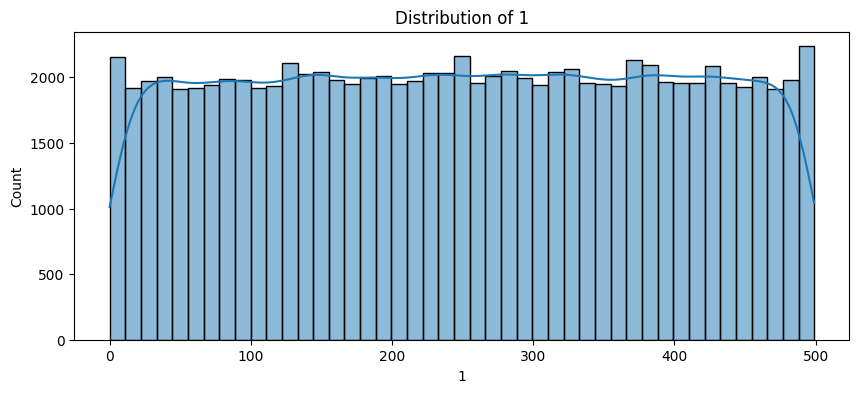

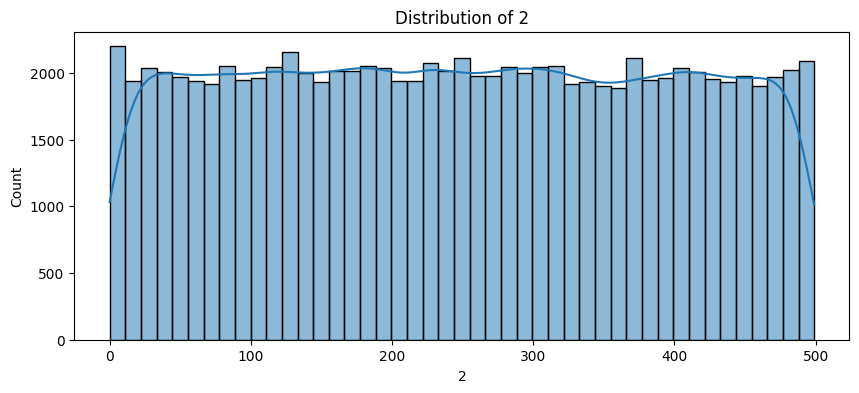

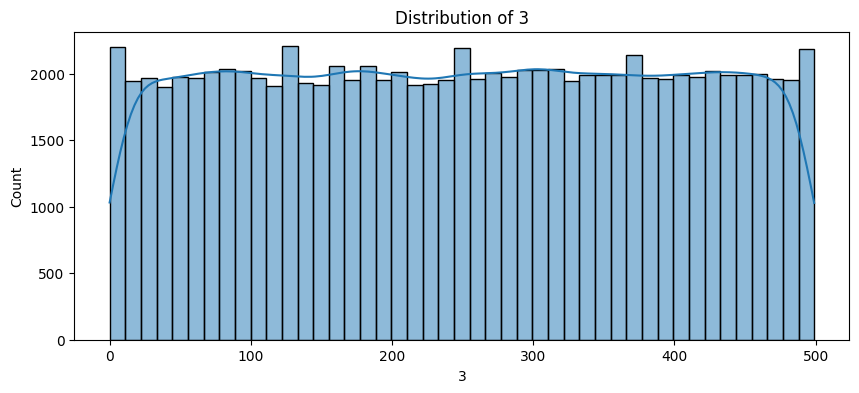

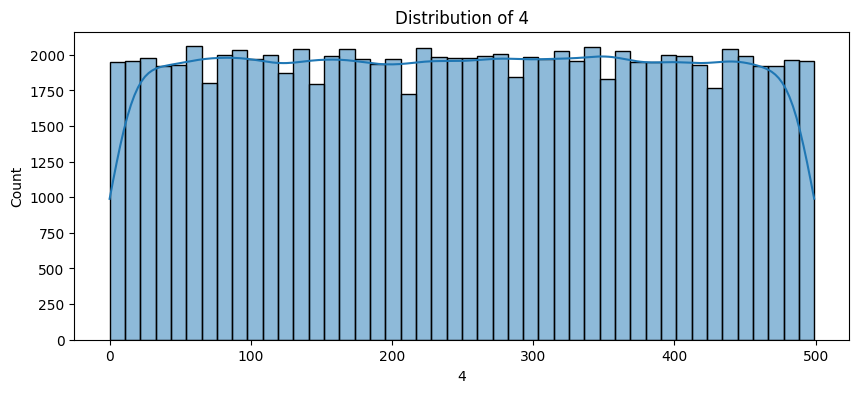

...

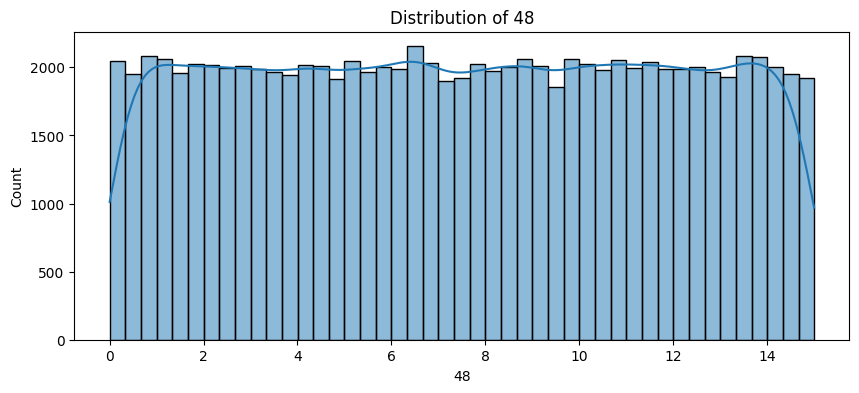

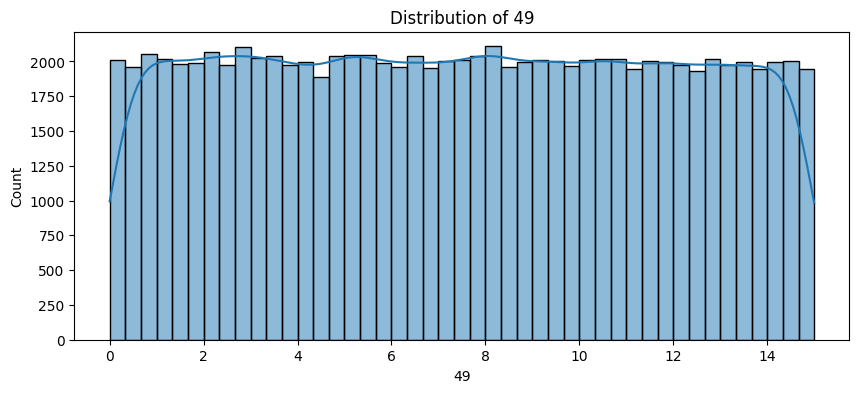

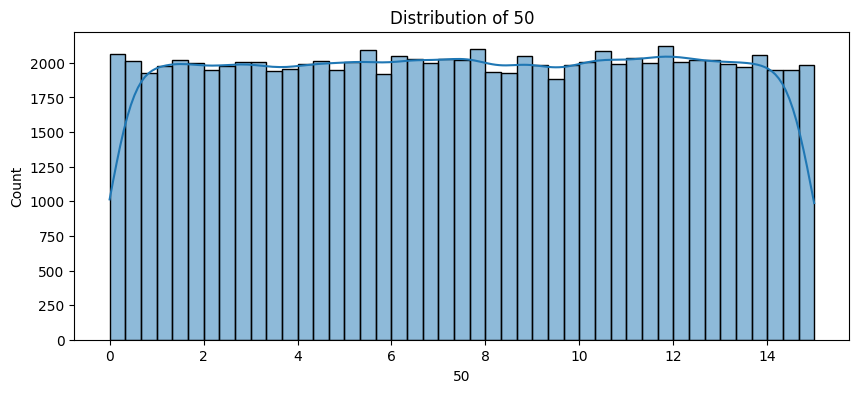

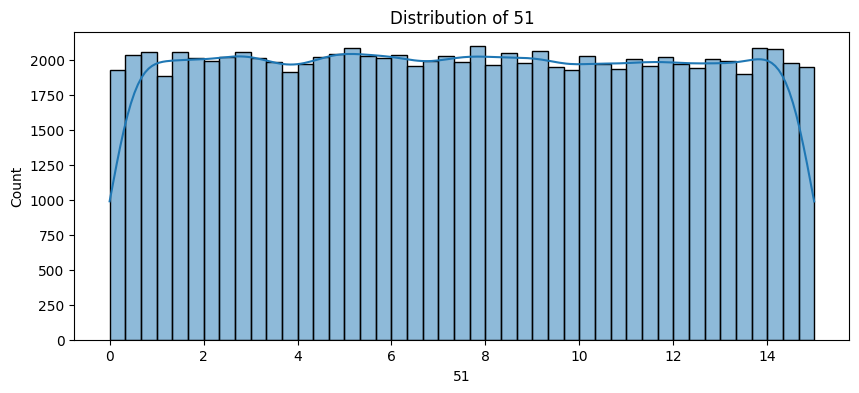

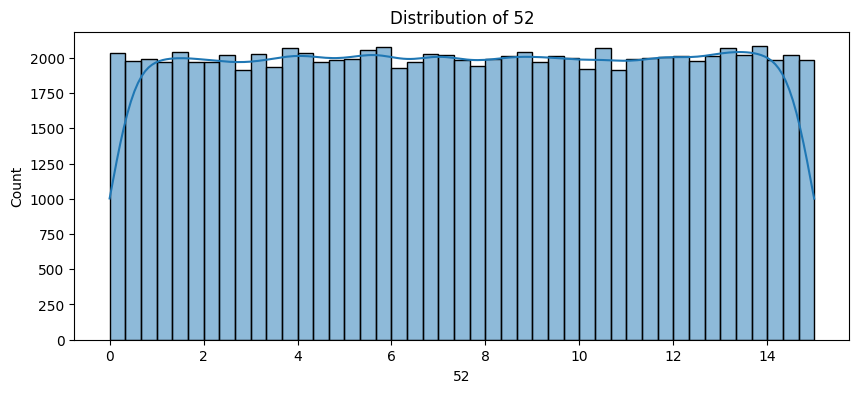

In [36]:
# Plotting histograms for the first few features to check their distributions
for column in train_data.columns[:53]: 
    plt.figure(figsize=(10, 4))
    sns.histplot(train_data[column], kde=True)
    plt.title(f'Distribution of {column}')
    plt.show()

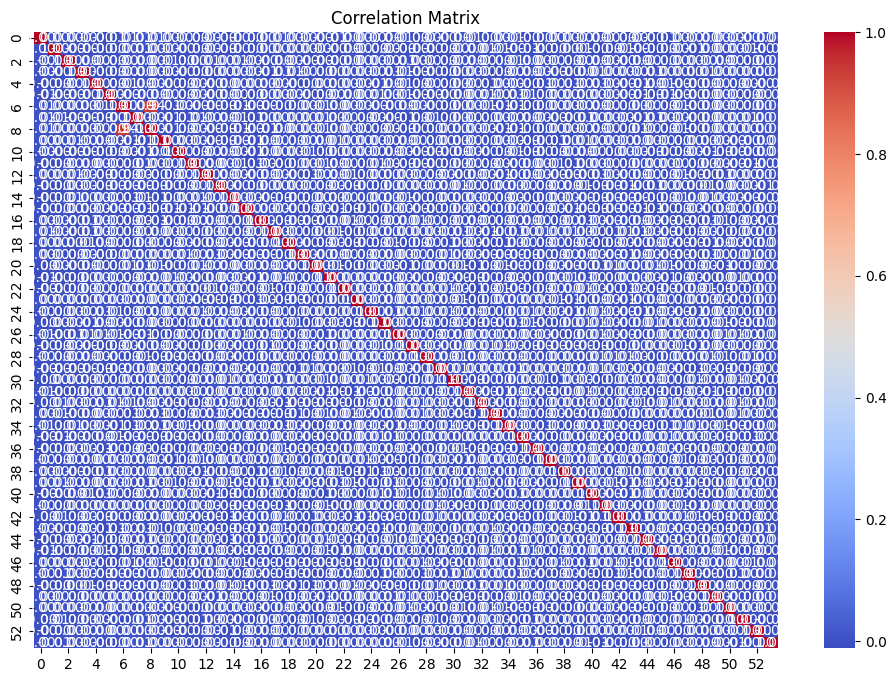

In [37]:
# Calculate the correlation matrix
corr_matrix = train_data.corr()

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [38]:
selected_features = ['6', '8', 'target']
data_selected = train_data[selected_features]

# Display first few rows to ensure correct data selection
print(data_selected.head())

          6  8     target
0 -4.472136  0  20.107472
1  7.810250  1  61.763713
2  8.602325  1  74.651162
3  8.306624  1  69.424645
4  8.124038  1  66.767304


In [39]:
# Calculate the correlation matrix
corr_matrix = data_selected.corr()

# Display the correlation matrix
print(corr_matrix)

               6         8    target
6       1.000000  0.940016  0.000666
8       0.940016  1.000000  0.000347
target  0.000666  0.000347  1.000000


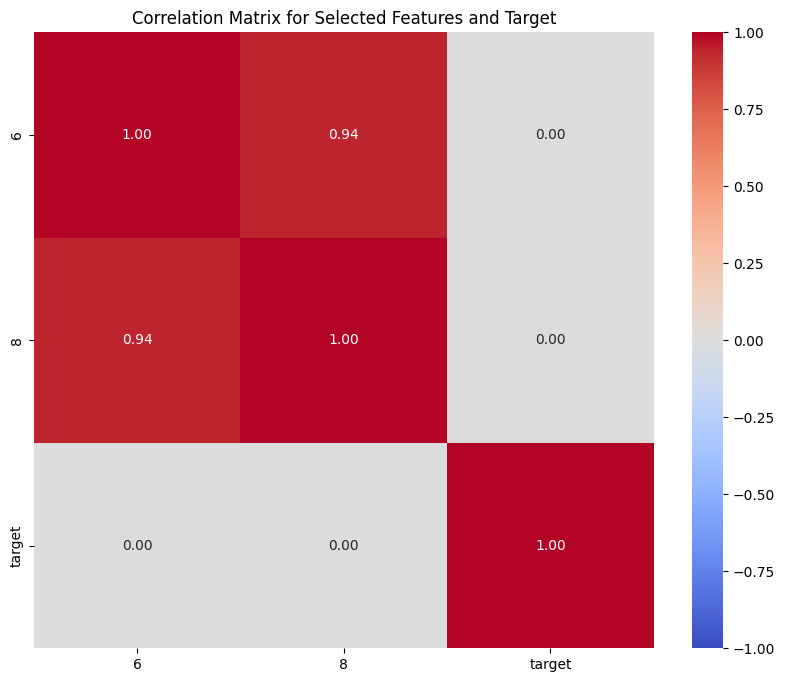

In [40]:
# Plot the heatmap for the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix for Selected Features and Target')
plt.show()

In [41]:
selected_features_uniform = ['1', '2', 'target']
data_selected_uniform = train_data[selected_features_uniform]

# Display first few rows to ensure correct data selection
print(data_selected_uniform.head())

     1    2     target
0  488   16  20.107472
1  206  357  61.763713
2   49  481  74.651162
3  350  481  69.424645
4  359   20  66.767304


In [42]:
# Calculate the correlation matrix
corr_matrix = data_selected_uniform.corr()

# Display the correlation matrix
print(corr_matrix)

               1         2    target
1       1.000000 -0.001849 -0.005545
2      -0.001849  1.000000  0.001003
target -0.005545  0.001003  1.000000


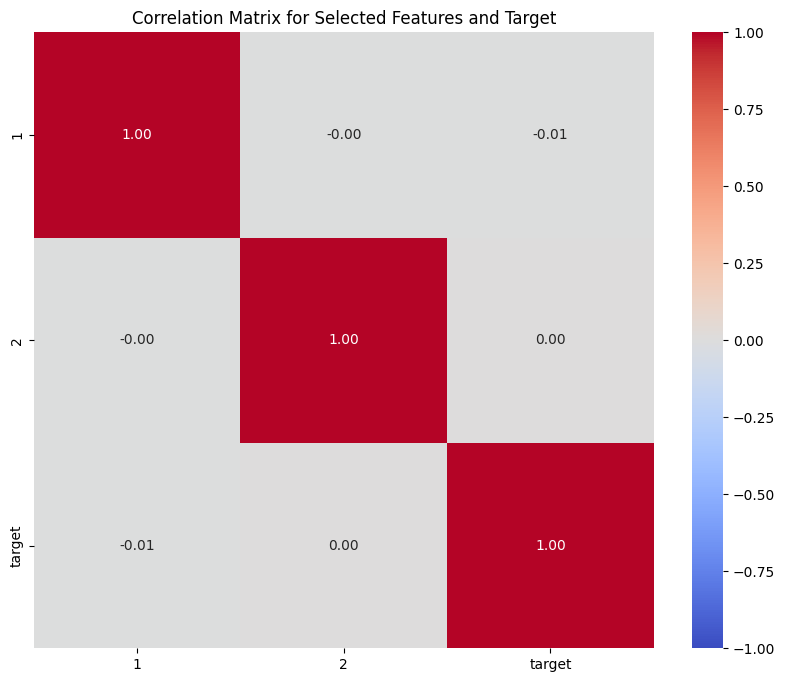

In [43]:
# Plot the heatmap for the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix for Selected Features and Target')
plt.show()

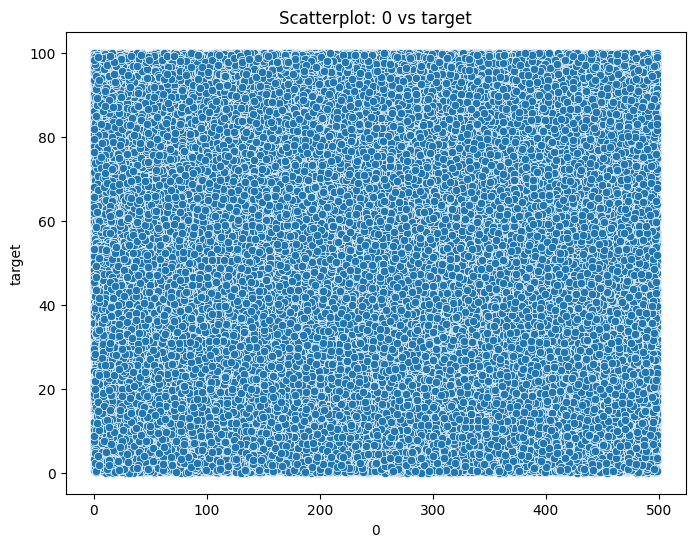

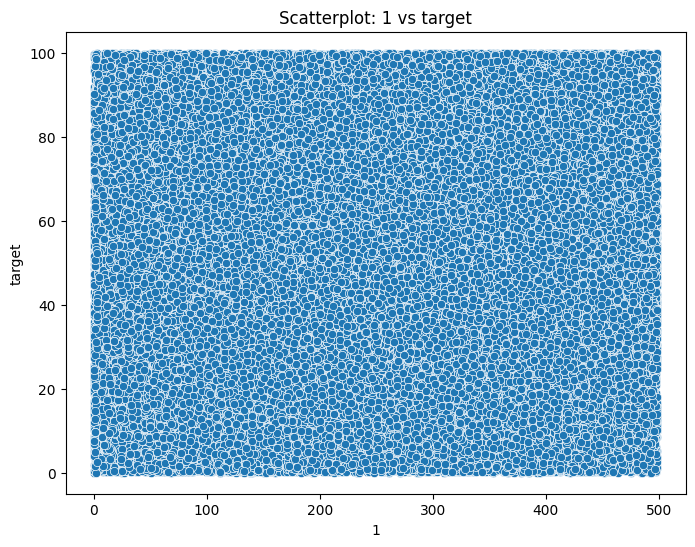

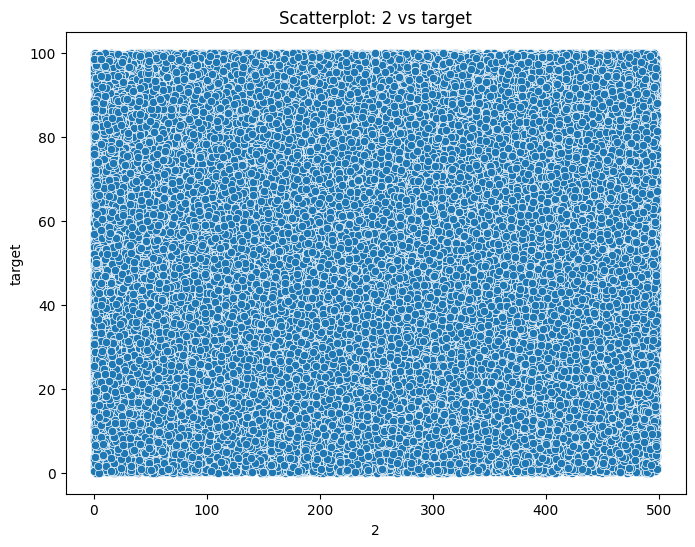

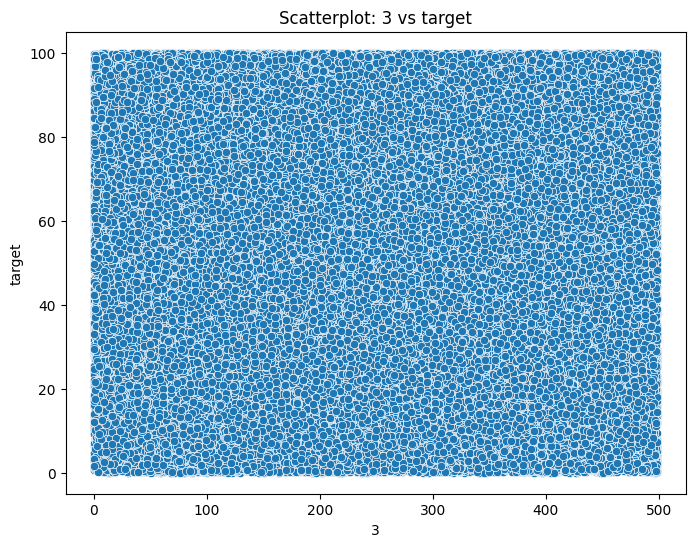

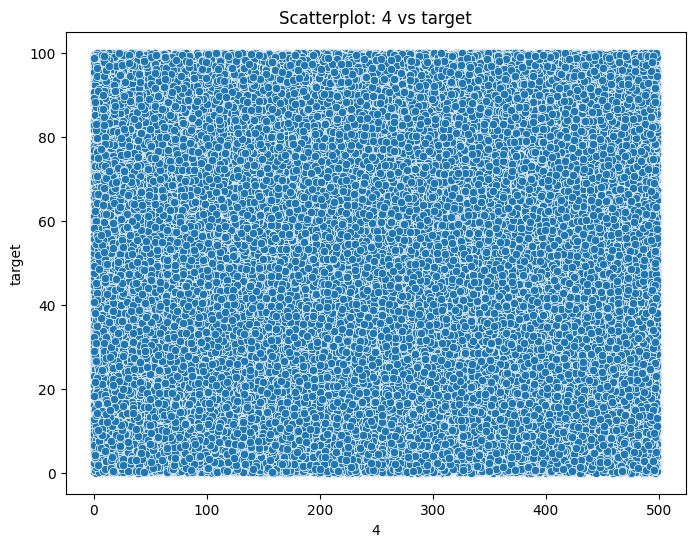

...

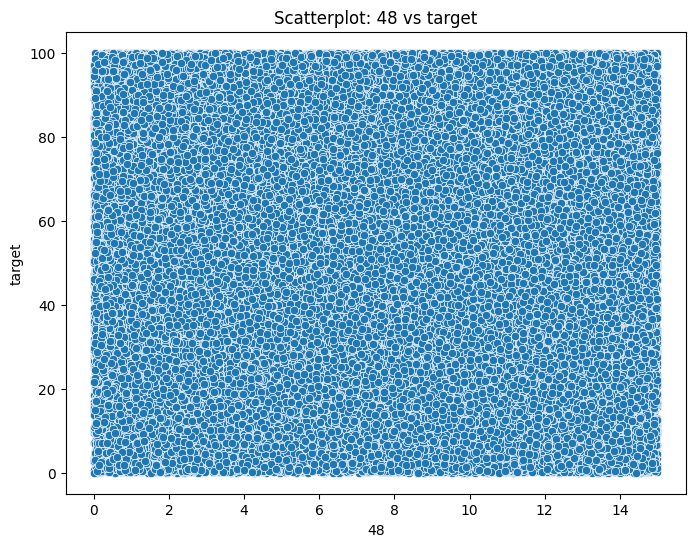

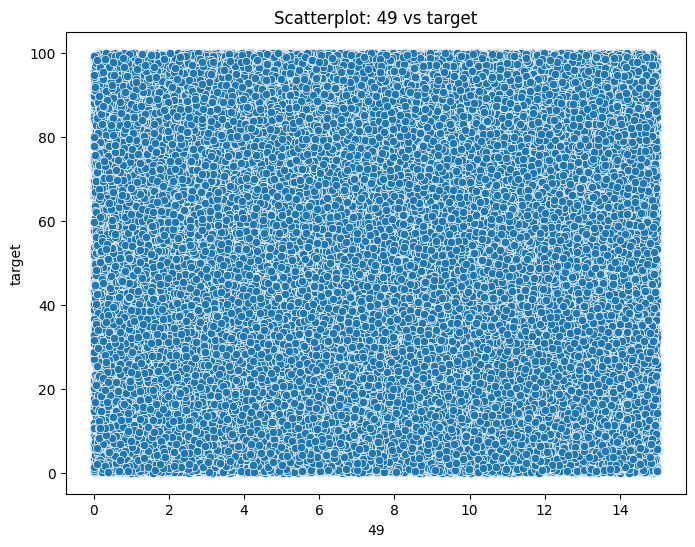

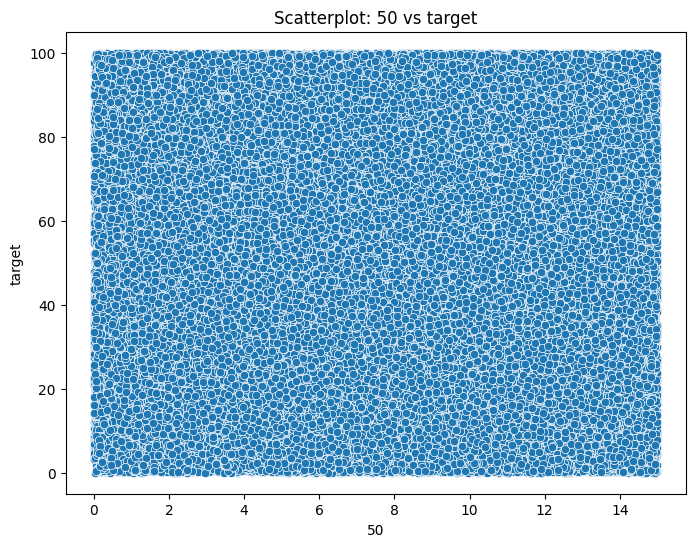

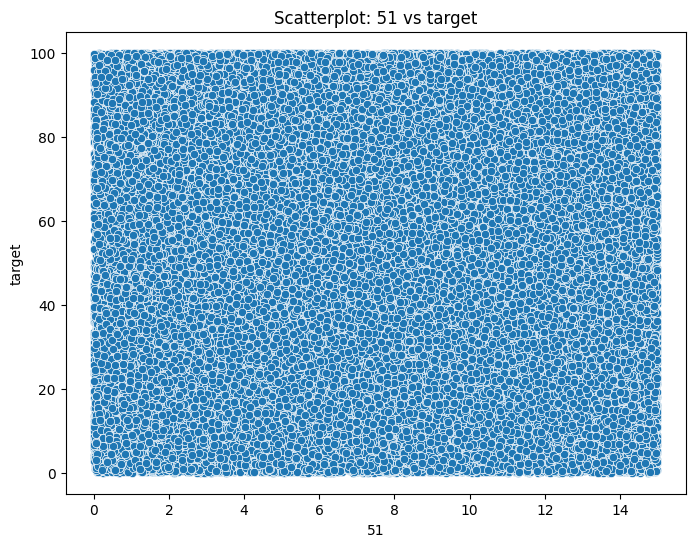

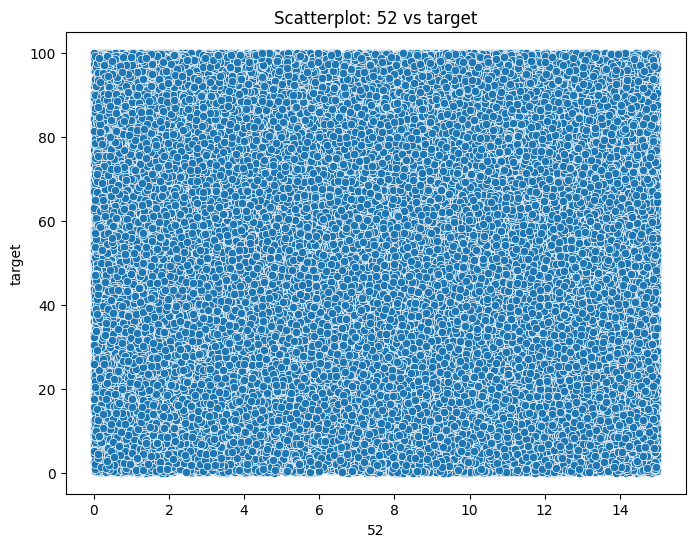

In [47]:
# Select features
selected_features = train_data.columns[:-1]
target = train_data.columns[-1]

# Create scatterplots for each selected feature against the target
for feature in selected_features:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=train_data[feature], y=train_data[target])
    plt.xlabel(feature)
    plt.ylabel(target)
    plt.title(f'Scatterplot: {feature} vs {target}')
    plt.show()

In [48]:
train_data['6'] = train_data['6'] ** 2

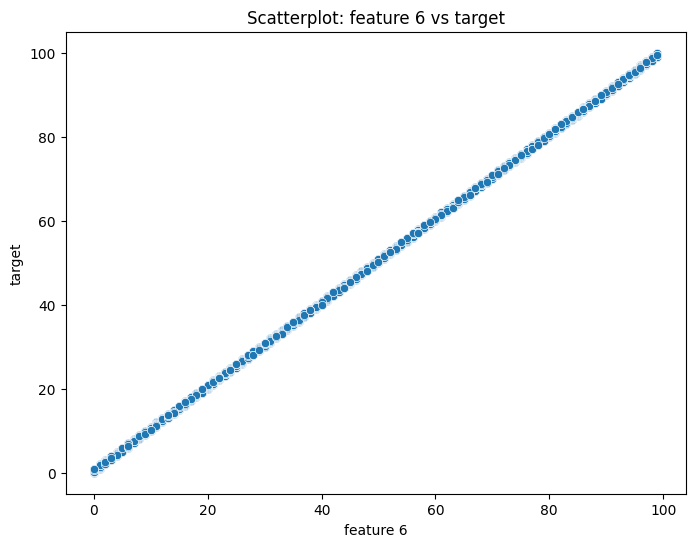

In [54]:
# Select the first 10 features
feature = train_data['6']
target = train_data['target']


plt.figure(figsize=(8, 6))
sns.scatterplot(x=feature, y=target)
plt.xlabel('feature 6')
plt.ylabel('target')
plt.title(f'Scatterplot: feature 6 vs target')
plt.show()

In [55]:
feature = '6'
target = 'target'

# Calculate the correlation
correlation = train_data[feature].corr(train_data[target])
print(f'Correlation between {feature} and {target}: {correlation}')

Correlation between 6 and target: 0.9999500992911138
